In [1]:
import duckdb
import pandas as pd
# Import jupysql Jupyter extension to create SQL cells
%load_ext sql
# Set configrations on jupysql to directly output data to Pandas and to simplify the output that is printed to the notebook.
%config SqlMagic.autopandas = True
%config SqlMagic.feedback = False
%config SqlMagic.displaycon = False

There's a new jupysql version available (0.6.0), you're running 0.5.6. To upgrade: pip install jupysql --upgrade


In [2]:
# Connect jupysql to DuckDB using a SQLAlchemy-style connection string. Either connect to an in memory DuckDB, or a file backed db.
# %sql duckdb:///path/to/file.db
%sql duckdb:///:memory:

In [2]:
%sql duckdb:////Users/Shared/dmmil/development/database/duckdb/duckdb.db

In [3]:
# Single line SQL queries can be run using %sql at the start of a line. Query results will be displayed as a Pandas DF.
%sql SELECT * FROM '../data/gsod.csv'

,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,TEMP,TEMP_ATTRIBUTES,DEWP,DEWP_ATTRIBUTES,...,MXSPD,GUST,MAX,MAX_ATTRIBUTES,MIN,MIN_ATTRIBUTES,PRCP,PRCP_ATTRIBUTES,SNDP,FRSHTT
0,01001099999,2020-01-01,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",31.5,24,29.3,24,...,15.9,24.1,35.8,,23.5,*,0.37,G,999.9,010000
1,01001099999,2020-01-02,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",26.0,24,23.4,24,...,37.3,49.1,34.2,*,19.0,,0.54,E,999.9,101000
2,01001099999,2020-01-03,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",25.1,21,18.9,21,...,50.5,65.9,33.6,*,19.6,*,0.31,E,999.9,010000
3,01001099999,2020-01-04,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",24.1,23,16.1,23,...,25.6,31.3,31.3,*,19.2,,0.06,G,999.9,001000
4,01001099999,2020-01-05,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",34.4,24,32.5,24,...,25.6,34.0,37.4,,26.4,,0.02,G,999.9,010000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
360,01001099999,2020-12-27,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",33.9,24,27.5,24,...,34.2,50.1,39.6,,29.1,,0.02,G,999.9,011000
361,01001099999,2020-12-28,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",30.2,24,23.3,24,...,38.9,49.9,31.3,,29.5,,0.00,G,999.9,000000
362,01001099999,2020-12-29,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",30.5,24,28.7,24,...,36.1,49.7,31.3,,29.3,,0.00,G,999.9,001000
363,01001099999,2020-12-30,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",31.1,24,29.4,24,...,30.3,40.0,32.4,,29.3,,0.59,G,999.9,001000


# An entire Jupyter cell can be used as a SQL cell by placing %%sql at the start of the cell. Query results will be displayed as a Pandas DF.

In [6]:
%%sql
SELECT
    *
FROM '../data/gsod.csv'
ORDER BY STATION
LIMIT 5

,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,TEMP,TEMP_ATTRIBUTES,DEWP,DEWP_ATTRIBUTES,...,MXSPD,GUST,MAX,MAX_ATTRIBUTES,MIN,MIN_ATTRIBUTES,PRCP,PRCP_ATTRIBUTES,SNDP,FRSHTT
0,01001099999,2020-07-01,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",35.2,24,32.3,24,...,26.6,35.2,40.3,,32.5,,0.00,G,999.9,100000
1,01001099999,2020-10-01,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",42.1,24,39.0,24,...,26.8,39.2,44.4,,37.9,,0.04,G,999.9,010000
2,01001099999,2020-04-03,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",13.6,24,8.0,24,...,34.4,47.6,21.7,,10.0,,0.03,G,999.9,100000
3,01001099999,2020-04-04,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",10.3,24,3.6,24,...,25.1,45.1,13.1,*,8.2,,0.06,G,999.9,001000
4,01001099999,2020-01-05,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",34.4,24,32.5,24,...,25.6,34.0,37.4,,26.4,,0.02,G,999.9,010000


In [12]:
# To return query results into a Pandas dataframe for future usage, use << as an assignment operator. This can be used with both the %sql and %%sql Jupyter magics.
%sql df << SELECT * FROM '../data/gsod.csv' LIMIT 10
df.head(10)

,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,TEMP,TEMP_ATTRIBUTES,DEWP,DEWP_ATTRIBUTES,...,MXSPD,GUST,MAX,MAX_ATTRIBUTES,MIN,MIN_ATTRIBUTES,PRCP,PRCP_ATTRIBUTES,SNDP,FRSHTT
0,01001099999,2020-01-01,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",31.5,24,29.3,24,...,15.9,24.1,35.8,,23.5,*,0.37,G,999.9,010000
1,01001099999,2020-01-02,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",26.0,24,23.4,24,...,37.3,49.1,34.2,*,19.0,,0.54,E,999.9,101000
2,01001099999,2020-01-03,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",25.1,21,18.9,21,...,50.5,65.9,33.6,*,19.6,*,0.31,E,999.9,010000
3,01001099999,2020-01-04,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",24.1,23,16.1,23,...,25.6,31.3,31.3,*,19.2,,0.06,G,999.9,001000
4,01001099999,2020-01-05,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",34.4,24,32.5,24,...,25.6,34.0,37.4,,26.4,,0.02,G,999.9,010000
5,01001099999,2020-01-06,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",35.7,22,33.2,22,...,28.9,39.2,38.3,*,33.4,,0.09,G,999.9,100000
6,01001099999,2020-01-07,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",32.9,24,30.4,24,...,28.0,35.5,37.9,,28.9,*,0.29,G,999.9,110000
7,01001099999,2020-01-08,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",31.7,24,29.2,24,...,32.8,57.3,32.9,,28.0,*,0.00,G,999.9,010000
8,01001099999,2020-01-09,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",29.1,24,22.0,24,...,35.2,52.6,32.7,,25.5,,0.12,G,999.9,011000
9,01001099999,2020-01-10,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",28.4,23,20.0,23,...,13.8,29.7,32.7,,24.8,,0.14,G,999.9,000000


In [13]:
%%sql
df1 <<
SELECT
    *
FROM '../data/gsod.csv'
ORDER BY STATION
LIMIT 10

In [14]:
df1.head(10)

,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,TEMP,TEMP_ATTRIBUTES,DEWP,DEWP_ATTRIBUTES,...,MXSPD,GUST,MAX,MAX_ATTRIBUTES,MIN,MIN_ATTRIBUTES,PRCP,PRCP_ATTRIBUTES,SNDP,FRSHTT
0,01001099999,2020-07-01,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",35.2,24,32.3,24,...,26.6,35.2,40.3,,32.5,,0.00,G,999.9,100000
1,01001099999,2020-10-01,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",42.1,24,39.0,24,...,26.8,39.2,44.4,,37.9,,0.04,G,999.9,010000
2,01001099999,2020-04-03,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",13.6,24,8.0,24,...,34.4,47.6,21.7,,10.0,,0.03,G,999.9,100000
3,01001099999,2020-04-04,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",10.3,24,3.6,24,...,25.1,45.1,13.1,*,8.2,,0.06,G,999.9,001000
4,01001099999,2020-01-05,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",34.4,24,32.5,24,...,25.6,34.0,37.4,,26.4,,0.02,G,999.9,010000
5,01001099999,2020-01-06,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",35.7,22,33.2,22,...,28.9,39.2,38.3,*,33.4,,0.09,G,999.9,100000
6,01001099999,2020-01-07,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",32.9,24,30.4,24,...,28.0,35.5,37.9,,28.9,*,0.29,G,999.9,110000
7,01001099999,2020-01-08,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",31.7,24,29.2,24,...,32.8,57.3,32.9,,28.0,*,0.00,G,999.9,010000
8,01001099999,2020-01-09,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",29.1,24,22.0,24,...,35.2,52.6,32.7,,25.5,,0.12,G,999.9,011000
9,01001099999,2020-01-10,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",28.4,23,20.0,23,...,13.8,29.7,32.7,,24.8,,0.14,G,999.9,000000


In [15]:
# Querying Pandas Dataframe
input_df = pd.read_csv('../data/gsod.csv')
%sql output_df << SELECT COUNT(*) as cnt FROM input_df
output_df.head

<bound method NDFrame.head of    cnt
0  365>

In [21]:
%sql select * from duckdb_extensions();

,extension_name,loaded,installed,install_path,description,aliases
0,excel,True,None,/Users/dmmil/.duckdb/extensions/v0.7.0/osx_amd...,,[]
1,fts,True,True,(BUILT-IN),Adds support for Full-Text Search Indexes,[]
2,httpfs,True,True,/Users/dmmil/.duckdb/extensions/v0.7.0/osx_amd...,Adds support for reading and writing files ove...,"[http, https, s3]"
3,icu,True,True,(BUILT-IN),Adds support for time zones and collations usi...,[]
4,inet,False,False,,Adds support for IP-related data types and fun...,[]
5,jemalloc,False,False,,Overwrites system allocator with JEMalloc,[]
6,json,True,True,(BUILT-IN),Adds support for JSON operations,[]
7,motherduck,False,False,,Enables motherduck integration with the system,[md]
8,parquet,True,True,(BUILT-IN),Adds support for reading and writing parquet f...,[]
9,postgres_scanner,False,False,,Adds support for reading from a Postgres database,[postgres]


In [20]:
%%sql
INSTALL excel;
LOAD excel;

""


In [24]:
%%sql --save short-trips
SELECT *
FROM "https://d37ci6vzurychx.cloudfront.net/trip-data/yellow_tripdata_2021-01.parquet"
WHERE trip_distance < 6.3

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,airport_fee
0,1,2021-01-01 00:30:10,2021-01-01 00:36:12,1.0,2.10,1.0,N,142,43,2,8.00,3.00,0.5,0.00,0.0,0.3,11.80,2.5,NaN
1,1,2021-01-01 00:51:20,2021-01-01 00:52:19,1.0,0.20,1.0,N,238,151,2,3.00,0.50,0.5,0.00,0.0,0.3,4.30,0.0,NaN
2,2,2021-01-01 00:31:49,2021-01-01 00:48:21,1.0,4.94,1.0,N,68,33,1,16.50,0.50,0.5,4.06,0.0,0.3,24.36,2.5,NaN
3,1,2021-01-01 00:16:29,2021-01-01 00:24:30,1.0,1.60,1.0,N,224,68,1,8.00,3.00,0.5,2.35,0.0,0.3,14.15,2.5,NaN
4,1,2021-01-01 00:00:28,2021-01-01 00:17:28,1.0,4.10,1.0,N,95,157,2,16.00,0.50,0.5,0.00,0.0,0.3,17.30,0.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1232108,6,2021-01-31 23:01:10,2021-01-31 23:01:54,NaN,3.23,NaN,None,265,61,0,16.49,0.00,0.5,0.00,0.0,0.3,17.29,NaN,NaN
1232109,1,2021-01-31 23:22:54,2021-01-31 23:35:00,NaN,0.00,NaN,None,161,151,0,12.20,0.50,0.5,3.20,0.0,0.3,21.20,NaN,NaN
1232110,2,2021-01-31 23:00:00,2021-01-31 23:08:00,NaN,1.55,NaN,None,41,74,0,7.11,0.00,0.5,0.16,0.0,0.3,8.07,NaN,NaN
1232111,2,2021-01-31 23:25:00,2021-01-31 23:38:00,NaN,6.26,NaN,None,74,137,0,16.85,0.00,0.5,3.90,0.0,0.3,24.05,NaN,NaN


<AxesSubplot:title={'center':"'trip_distance' from 'https://d37ci6vzurychx.cloudfront.net/trip-data/yellow_tripdata_2021-01.parquet'"}, ylabel='trip_distance'>

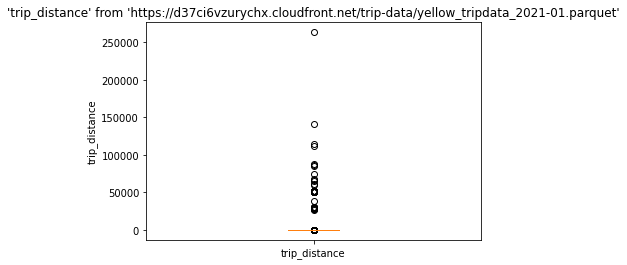

In [25]:
%sqlplot boxplot --table https://d37ci6vzurychx.cloudfront.net/trip-data/yellow_tripdata_2021-01.parquet --column trip_distance

In [26]:
%%sql --save short-trips --no-execute
SELECT *
FROM "https://d37ci6vzurychx.cloudfront.net/trip-data/yellow_tripdata_2021-01.parquet"
WHERE trip_distance < 6.3

Skipping execution...


<AxesSubplot:title={'center':"'temp' from '../data/gsod.csv'"}, ylabel='temp'>

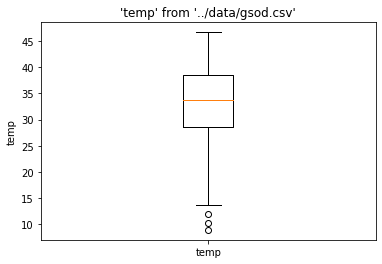

In [32]:
%sqlplot boxplot --table ../data/gsod.csv --column temp

<AxesSubplot:title={'center':"'trip_distance' from 'https://d37ci6vzurychx.cloudfront.net/trip-data/yellow_tripdata_2021-01.parquet'"}, xlabel='trip_distance', ylabel='Count'>

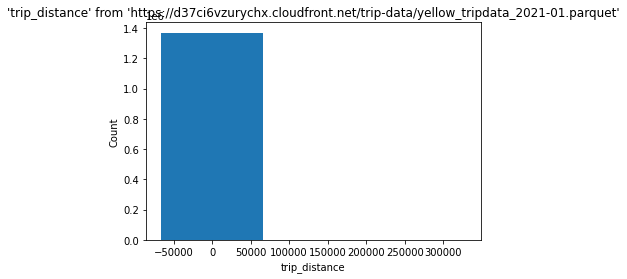

In [34]:
%sqlplot histogram --table https://d37ci6vzurychx.cloudfront.net/trip-data/yellow_tripdata_2021-01.parquet --column trip_distance --bins 10

In [35]:
%%sql --save short-trips --no-execute
SELECT *
FROM "https://d37ci6vzurychx.cloudfront.net/trip-data/yellow_tripdata_2021-01.parquet"
WHERE trip_distance < 6.3

Skipping execution...


<AxesSubplot:title={'center':"'trip_distance' from 'short-trips'"}, xlabel='trip_distance', ylabel='Count'>

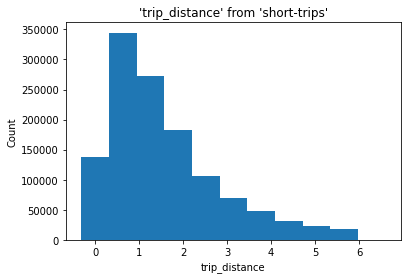

In [41]:
%sqlplot histogram --table short-trips --column trip_distance --bins 10 --with short-trips

<AxesSubplot:title={'center':"'temp' from '../data/gsod.csv'"}, xlabel='temp', ylabel='Count'>

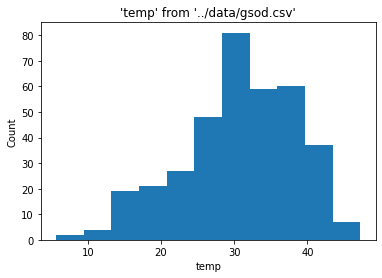

In [44]:
%sqlplot histogram --table ../data/gsod.csv --column temp --bins 10

In [45]:
%sql CREATE TABLE students(sid INTEGER PRIMARY KEY, name VARCHAR);

""


In [46]:
%sql show tables

,name
0,students


In [48]:
%sql describe students

,column_name,column_type,null,key,default,extra
0,sid,INTEGER,NO,None,None,None
1,name,VARCHAR,YES,None,None,None


In [49]:
%sql CREATE TABLE mytab as select * from '../data/gsod.csv'

,Count
0,365


In [50]:
%sql show tables

,name
0,mytab
1,students


In [51]:
%sql describe mytab

,column_name,column_type,null,key,default,extra
0,STATION,VARCHAR,YES,None,None,None
1,DATE,DATE,YES,None,None,None
2,LATITUDE,DOUBLE,YES,None,None,None
3,LONGITUDE,DOUBLE,YES,None,None,None
4,ELEVATION,DOUBLE,YES,None,None,None
5,NAME,VARCHAR,YES,None,None,None
6,TEMP,DOUBLE,YES,None,None,None
7,TEMP_ATTRIBUTES,BIGINT,YES,None,None,None
8,DEWP,DOUBLE,YES,None,None,None
9,DEWP_ATTRIBUTES,BIGINT,YES,None,None,None


In [52]:
%sql select * from mytab

,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,TEMP,TEMP_ATTRIBUTES,DEWP,DEWP_ATTRIBUTES,...,MXSPD,GUST,MAX,MAX_ATTRIBUTES,MIN,MIN_ATTRIBUTES,PRCP,PRCP_ATTRIBUTES,SNDP,FRSHTT
0,01001099999,2020-01-01,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",31.5,24,29.3,24,...,15.9,24.1,35.8,,23.5,*,0.37,G,999.9,010000
1,01001099999,2020-01-02,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",26.0,24,23.4,24,...,37.3,49.1,34.2,*,19.0,,0.54,E,999.9,101000
2,01001099999,2020-01-03,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",25.1,21,18.9,21,...,50.5,65.9,33.6,*,19.6,*,0.31,E,999.9,010000
3,01001099999,2020-01-04,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",24.1,23,16.1,23,...,25.6,31.3,31.3,*,19.2,,0.06,G,999.9,001000
4,01001099999,2020-01-05,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",34.4,24,32.5,24,...,25.6,34.0,37.4,,26.4,,0.02,G,999.9,010000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
360,01001099999,2020-12-27,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",33.9,24,27.5,24,...,34.2,50.1,39.6,,29.1,,0.02,G,999.9,011000
361,01001099999,2020-12-28,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",30.2,24,23.3,24,...,38.9,49.9,31.3,,29.5,,0.00,G,999.9,000000
362,01001099999,2020-12-29,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",30.5,24,28.7,24,...,36.1,49.7,31.3,,29.3,,0.00,G,999.9,001000
363,01001099999,2020-12-30,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",31.1,24,29.4,24,...,30.3,40.0,32.4,,29.3,,0.59,G,999.9,001000


In [53]:
%sql CREATE TABLE students(sid INTEGER PRIMARY KEY, name VARCHAR);
%sql CREATE TABLE exams(cid INTEGER, sid INTEGER, grade INTEGER, PRIMARY KEY(cid, sid));

(duckdb.CatalogException) Catalog Error: Table with name "students" already exists!
[SQL: CREATE TABLE students(sid INTEGER PRIMARY KEY, name VARCHAR);]
(Background on this error at: https://sqlalche.me/e/14/f405)


""


In [54]:
%sql  INSERT INTO students VALUES (1, 'Mark'), (2, 'Hannes'), (3, 'Pedro');

,Count
0,3


In [55]:
%sql INSERT INTO exams VALUES (1, 1, 8), (1, 2, 8), (1, 3, 7), (2, 1, 9), (2, 2, 10);

,Count
0,5


In [56]:
%sql CREATE TABLE gsod AS SELECT * FROM '../data/gsod.csv'

,Count
0,365


In [59]:
%sql SHOW TABLES

,name
0,exams
1,gsod
2,students


In [58]:
%sql drop table mytab

""


In [60]:
%sql DESCRIBE gsod

,column_name,column_type,null,key,default,extra
0,STATION,VARCHAR,YES,None,None,None
1,DATE,DATE,YES,None,None,None
2,LATITUDE,DOUBLE,YES,None,None,None
3,LONGITUDE,DOUBLE,YES,None,None,None
4,ELEVATION,DOUBLE,YES,None,None,None
5,NAME,VARCHAR,YES,None,None,None
6,TEMP,DOUBLE,YES,None,None,None
7,TEMP_ATTRIBUTES,BIGINT,YES,None,None,None
8,DEWP,DOUBLE,YES,None,None,None
9,DEWP_ATTRIBUTES,BIGINT,YES,None,None,None


In [4]:
%sql SELECT * FROM gsod LIMIT 10

,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,TEMP,TEMP_ATTRIBUTES,DEWP,DEWP_ATTRIBUTES,...,MXSPD,GUST,MAX,MAX_ATTRIBUTES,MIN,MIN_ATTRIBUTES,PRCP,PRCP_ATTRIBUTES,SNDP,FRSHTT
0,01001099999,2020-01-01,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",31.5,24,29.3,24,...,15.9,24.1,35.8,,23.5,*,0.37,G,999.9,010000
1,01001099999,2020-01-02,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",26.0,24,23.4,24,...,37.3,49.1,34.2,*,19.0,,0.54,E,999.9,101000
2,01001099999,2020-01-03,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",25.1,21,18.9,21,...,50.5,65.9,33.6,*,19.6,*,0.31,E,999.9,010000
3,01001099999,2020-01-04,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",24.1,23,16.1,23,...,25.6,31.3,31.3,*,19.2,,0.06,G,999.9,001000
4,01001099999,2020-01-05,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",34.4,24,32.5,24,...,25.6,34.0,37.4,,26.4,,0.02,G,999.9,010000
5,01001099999,2020-01-06,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",35.7,22,33.2,22,...,28.9,39.2,38.3,*,33.4,,0.09,G,999.9,100000
6,01001099999,2020-01-07,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",32.9,24,30.4,24,...,28.0,35.5,37.9,,28.9,*,0.29,G,999.9,110000
7,01001099999,2020-01-08,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",31.7,24,29.2,24,...,32.8,57.3,32.9,,28.0,*,0.00,G,999.9,010000
8,01001099999,2020-01-09,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",29.1,24,22.0,24,...,35.2,52.6,32.7,,25.5,,0.12,G,999.9,011000
9,01001099999,2020-01-10,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",28.4,23,20.0,23,...,13.8,29.7,32.7,,24.8,,0.14,G,999.9,000000


In [66]:
%sql show tables

""


In [67]:
%sql CREATE TABLE gsod AS SELECT * FROM '../data/gsod.csv'

,Count
0,365


In [3]:
%sql show tables

,name
0,gsod
1,japan_trade_stats_1988_2019


In [5]:
%sql select sum(column7) from japan_trade_stats_1988_2019

,sum(column7)
0,3681820443472


In [5]:
%sql SELECT r.i FROM range(100) AS r(i)

,i
0,0
1,1
2,2
3,3
4,4
...,...
95,95
96,96
97,97
98,98


In [6]:
%sql SELECT * FROM gsod TABLESAMPLE 10 ROWS;

,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,TEMP,TEMP_ATTRIBUTES,DEWP,DEWP_ATTRIBUTES,...,MXSPD,GUST,MAX,MAX_ATTRIBUTES,MIN,MIN_ATTRIBUTES,PRCP,PRCP_ATTRIBUTES,SNDP,FRSHTT
0,01001099999,2020-02-01,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",25.0,22,20.7,22,...,31.1,42.2,28.8,*,23.0,*,0.02,E,999.9,001000
1,01001099999,2020-05-10,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",22.2,24,16.1,24,...,28.7,36.5,23.0,,20.5,,0.05,G,999.9,001000
2,01001099999,2020-11-15,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",23.2,24,14.4,24,...,32.4,45.8,26.8,,19.9,,0.36,G,999.9,000000
3,01001099999,2020-06-14,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",37.2,24,33.3,24,...,31.5,46.6,41.7,,32.5,,0.00,G,999.9,010000
4,01001099999,2020-08-06,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",46.6,24,45.1,24,...,12.4,16.3,48.6,,42.3,,0.00,G,999.9,010000
5,01001099999,2020-10-18,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",32.0,24,25.8,24,...,16.3,20.2,34.9,,27.3,,0.02,G,999.9,000000
6,01001099999,2020-10-21,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",29.5,24,25.4,24,...,8.7,10.3,34.3,,25.0,,0.00,E,999.9,001000
7,01001099999,2020-01-30,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",34.0,24,30.1,24,...,21.4,29.7,35.8,,32.2,,0.00,G,999.9,011000
8,01001099999,2020-06-26,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",41.1,24,39.4,24,...,10.5,14.4,43.7,,37.4,*,0.00,G,999.9,100000
9,01001099999,2020-10-20,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",30.1,23,26.0,23,...,13.6,17.5,32.0,,26.6,,0.02,E,999.9,001000


In [16]:
%sql SELECT * FROM gsod USING SAMPLE 10%

""


In [10]:
%%sql
SELECT station, date, AVG(temp)
FROM gsod
GROUP BY GROUPING SETS ((station, date), (station), (date), ());

,STATION,DATE,"avg(""temp"")"
0,01001099999,2020-01-01,31.500000
1,01001099999,2020-01-02,26.000000
2,01001099999,2020-01-03,25.100000
3,01001099999,2020-01-04,24.100000
4,01001099999,2020-01-05,34.400000
...,...,...,...
727,None,2020-12-24,28.100000
728,None,2020-03-29,26.700000
729,None,2020-09-03,41.300000
730,None,2020-12-02,28.500000


In [11]:
%%sql
SELECT station, date, AVG(temp)
FROM gsod
GROUP BY CUBE (station, date)

,STATION,DATE,"avg(""temp"")"
0,None,None,32.702466
1,01001099999,None,32.702466
2,01001099999,2020-01-01,31.500000
3,01001099999,2020-01-02,26.000000
4,01001099999,2020-01-03,25.100000
...,...,...,...
727,None,2020-12-19,35.300000
728,None,2020-12-24,28.100000
729,None,2020-03-29,26.700000
730,None,2020-09-03,41.300000


In [12]:
%%sql
SELECT station, date, AVG(temp)
FROM gsod
GROUP BY ROLLUP (station, date)

,STATION,DATE,"avg(""temp"")"
0,None,None,32.702466
1,01001099999,None,32.702466
2,01001099999,2020-01-01,31.500000
3,01001099999,2020-01-02,26.000000
4,01001099999,2020-01-03,25.100000
...,...,...,...
362,01001099999,2020-11-13,35.800000
363,01001099999,2020-12-05,22.600000
364,01001099999,2020-12-19,35.300000
365,01001099999,2020-12-24,28.100000


In [18]:
%sql SELECT  UNNEST([1, 2, 3]), UNNEST([10, 11]);

,"unnest(main.list_value(1, 2, 3))","unnest(main.list_value(10, 11))"
0,1,10.0
1,2,11.0
2,3,NaN


In [20]:
%sql SELECT UNNEST([1, 2, 3]) AS X, 10 AS Y;

,X,Y
0,1,10
1,2,10
2,3,10


In [24]:
%sql SELECT UNNEST(l) + 10 FROM (VALUES ([1, 2, 3]), ([4, 5])) tbl(l);

,(unnest(l) + 10)
0,11
1,12
2,13
3,14
4,15


In [25]:
%%sql
WITH cte AS (SELECT * FROM gsod)
SELECT * FROM cte;

,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,TEMP,TEMP_ATTRIBUTES,DEWP,DEWP_ATTRIBUTES,...,MXSPD,GUST,MAX,MAX_ATTRIBUTES,MIN,MIN_ATTRIBUTES,PRCP,PRCP_ATTRIBUTES,SNDP,FRSHTT
0,01001099999,2020-01-01,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",31.5,24,29.3,24,...,15.9,24.1,35.8,,23.5,*,0.37,G,999.9,010000
1,01001099999,2020-01-02,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",26.0,24,23.4,24,...,37.3,49.1,34.2,*,19.0,,0.54,E,999.9,101000
2,01001099999,2020-01-03,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",25.1,21,18.9,21,...,50.5,65.9,33.6,*,19.6,*,0.31,E,999.9,010000
3,01001099999,2020-01-04,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",24.1,23,16.1,23,...,25.6,31.3,31.3,*,19.2,,0.06,G,999.9,001000
4,01001099999,2020-01-05,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",34.4,24,32.5,24,...,25.6,34.0,37.4,,26.4,,0.02,G,999.9,010000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
360,01001099999,2020-12-27,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",33.9,24,27.5,24,...,34.2,50.1,39.6,,29.1,,0.02,G,999.9,011000
361,01001099999,2020-12-28,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",30.2,24,23.3,24,...,38.9,49.9,31.3,,29.5,,0.00,G,999.9,000000
362,01001099999,2020-12-29,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",30.5,24,28.7,24,...,36.1,49.7,31.3,,29.3,,0.00,G,999.9,001000
363,01001099999,2020-12-30,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",31.1,24,29.4,24,...,30.3,40.0,32.4,,29.3,,0.59,G,999.9,001000


In [26]:
%%sql
CREATE TABLE tag(id int, name varchar, subclassof int);
INSERT INTO tag VALUES
 (1, 'U2',     5),
 (2, 'Blur',   5),
 (3, 'Oasis',  5),
 (4, '2Pac',   6),
 (5, 'Rock',   7),
 (6, 'Rap',    7),
 (7, 'Music',  9),
 (8, 'Movies', 9),
 (9, 'Art', NULL);

,Count
0,9


In [27]:
%sql select * from tag

,id,name,subclassof
0,1,U2,5.0
1,2,Blur,5.0
2,3,Oasis,5.0
3,4,2Pac,6.0
4,5,Rock,7.0
5,6,Rap,7.0
6,7,Music,9.0
7,8,Movies,9.0
8,9,Art,NaN


In [28]:
%%sql
WITH RECURSIVE tag_hierarchy(id, source, path) AS (
      SELECT id, name, [name] AS path
      FROM tag
      WHERE subclassof IS NULL
UNION ALL
  SELECT tag.id, tag.name, list_prepend(tag.name, tag_hierarchy.path)
  FROM tag, tag_hierarchy
  WHERE tag.subclassof = tag_hierarchy.id
)
SELECT path
FROM tag_hierarchy
WHERE source = 'Oasis';


,path
0,"[Oasis, Rock, Music, Art]"


In [29]:
%%sql
CREATE TABLE edge(node1id int, node2id int);
INSERT INTO edge VALUES (1, 3), (1, 5), (2, 4), (2, 5), (2, 10), (3, 1), (3, 5),
  (3, 8), (3, 10), (5, 3), (5, 4), (5, 8), (6, 3), (6, 4), (7, 4), (8, 1), (9, 4);

,Count
0,17


In [30]:
%sql select * from edge

,node1id,node2id
0,1,3
1,1,5
2,2,4
3,2,5
4,2,10
5,3,1
6,3,5
7,3,8
8,3,10
9,5,3


In [31]:
%sql SELECT * FROM gsod

,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,TEMP,TEMP_ATTRIBUTES,DEWP,DEWP_ATTRIBUTES,...,MXSPD,GUST,MAX,MAX_ATTRIBUTES,MIN,MIN_ATTRIBUTES,PRCP,PRCP_ATTRIBUTES,SNDP,FRSHTT
0,01001099999,2020-01-01,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",31.5,24,29.3,24,...,15.9,24.1,35.8,,23.5,*,0.37,G,999.9,010000
1,01001099999,2020-01-02,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",26.0,24,23.4,24,...,37.3,49.1,34.2,*,19.0,,0.54,E,999.9,101000
2,01001099999,2020-01-03,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",25.1,21,18.9,21,...,50.5,65.9,33.6,*,19.6,*,0.31,E,999.9,010000
3,01001099999,2020-01-04,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",24.1,23,16.1,23,...,25.6,31.3,31.3,*,19.2,,0.06,G,999.9,001000
4,01001099999,2020-01-05,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",34.4,24,32.5,24,...,25.6,34.0,37.4,,26.4,,0.02,G,999.9,010000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
360,01001099999,2020-12-27,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",33.9,24,27.5,24,...,34.2,50.1,39.6,,29.1,,0.02,G,999.9,011000
361,01001099999,2020-12-28,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",30.2,24,23.3,24,...,38.9,49.9,31.3,,29.5,,0.00,G,999.9,000000
362,01001099999,2020-12-29,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",30.5,24,28.7,24,...,36.1,49.7,31.3,,29.3,,0.00,G,999.9,001000
363,01001099999,2020-12-30,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",31.1,24,29.4,24,...,30.3,40.0,32.4,,29.3,,0.59,G,999.9,001000


In [34]:
%%sql
SELECT
	STATION,
	DATE,
	TEMP,
	ROW_NUMBER() OVER (PARTITION BY STATION ORDER BY STATION, DATE) AS row_num
FROM gsod
ORDER BY STATION, DATE

,STATION,DATE,TEMP,row_num
0,01001099999,2020-01-01,31.5,1
1,01001099999,2020-01-02,26.0,2
2,01001099999,2020-01-03,25.1,3
3,01001099999,2020-01-04,24.1,4
4,01001099999,2020-01-05,34.4,5
...,...,...,...,...
360,01001099999,2020-12-27,33.9,361
361,01001099999,2020-12-28,30.2,362
362,01001099999,2020-12-29,30.5,363
363,01001099999,2020-12-30,31.1,364


In [37]:
%%sql
SELECT
	STATION,
	DATE,
	TEMP,
	AVG(TEMP) OVER (ROWS BETWEEN 1 PRECEDING  AND 1 FOLLOWING) AS frame_avg,
	SUM(TEMP) OVER (ROWS BETWEEN 1 PRECEDING  AND 1 FOLLOWING) AS frame_sum
FROM gsod
ORDER BY STATION, DATE

,STATION,DATE,TEMP,frame_avg,frame_sum
0,01001099999,2020-01-01,31.5,28.750000,57.5
1,01001099999,2020-01-02,26.0,27.533333,82.6
2,01001099999,2020-01-03,25.1,25.066667,75.2
3,01001099999,2020-01-04,24.1,27.866667,83.6
4,01001099999,2020-01-05,34.4,31.400000,94.2
...,...,...,...,...,...
360,01001099999,2020-12-27,33.9,33.100000,99.3
361,01001099999,2020-12-28,30.2,31.533333,94.6
362,01001099999,2020-12-29,30.5,30.600000,91.8
363,01001099999,2020-12-30,31.1,29.466667,88.4


In [40]:
%%sql
SELECT
	STATION,
	DATE,
	TEMP,
	AVG(TEMP) OVER (PARTITION BY STATION ORDER BY DATE RANGE BETWEEN INTERVAL 3 DAYS PRECEDING AND INTERVAL 3 DAYS FOLLOWING) AS frame_avg,
FROM gsod
ORDER BY STATION, DATE

,STATION,DATE,TEMP,frame_avg
0,01001099999,2020-01-01,31.5,26.675000
1,01001099999,2020-01-02,26.0,28.220000
2,01001099999,2020-01-03,25.1,29.466667
3,01001099999,2020-01-04,24.1,29.957143
4,01001099999,2020-01-05,34.4,29.985714
...,...,...,...,...
360,01001099999,2020-12-27,33.9,32.042857
361,01001099999,2020-12-28,30.2,31.857143
362,01001099999,2020-12-29,30.5,31.283333
363,01001099999,2020-12-30,31.1,30.500000


In [41]:
%%sql
SELECT
STATION,
DATE,
TEMP,
MIN(TEMP) OVER seven_days AS "7-day Moving Minimum",
AVG(TEMP) OVER seven_days AS "7-day Moving Average",
MAX(TEMP) OVER seven_days AS "7-day Moving Maximum"
FROM gsod
WINDOW seven_days AS (
    PARTITION BY STATION
ORDER BY  DATE ASC
RANGE BETWEEN INTERVAL 3 DAYS PRECEDING AND INTERVAL 3 DAYS FOLLOWING)
ORDER BY STATION, DATE


,STATION,DATE,TEMP,7-day Moving Minimum,7-day Moving Average,7-day Moving Maximum
0,01001099999,2020-01-01,31.5,24.1,26.675000,31.5
1,01001099999,2020-01-02,26.0,24.1,28.220000,34.4
2,01001099999,2020-01-03,25.1,24.1,29.466667,35.7
3,01001099999,2020-01-04,24.1,24.1,29.957143,35.7
4,01001099999,2020-01-05,34.4,24.1,29.985714,35.7
...,...,...,...,...,...,...
360,01001099999,2020-12-27,33.9,28.1,32.042857,35.3
361,01001099999,2020-12-28,30.2,26.8,31.857143,35.3
362,01001099999,2020-12-29,30.5,26.8,31.283333,35.2
363,01001099999,2020-12-30,31.1,26.8,30.500000,33.9


In [44]:
%%sql
SELECT
     STATION,
     DATE,
    TEMP,
    MIN(TEMP) OVER seven_days AS "7-day Moving Minimum",
    QUANTILE_CONT(TEMP, [0.25, 0.5, 0.75]) OVER seven_days AS "7-day Moving IQR",
    MAX(TEMP) OVER seven_days AS "7-day Moving Maximum"
FROM gsod
WINDOW seven_days  AS (
    PARTITION BY STATION
    ORDER BY  DATE ASC
    RANGE BETWEEN INTERVAL 3 DAYS PRECEDING AND INTERVAL 3 DAYS FOLLOWING)
ORDER BY STATION, DATE

,STATION,DATE,TEMP,7-day Moving Minimum,7-day Moving IQR,7-day Moving Maximum
0,01001099999,2020-01-01,31.5,24.1,"[24.85, 25.55, 27.375]",31.5
1,01001099999,2020-01-02,26.0,24.1,"[25.1, 26.0, 31.5]",34.4
2,01001099999,2020-01-03,25.1,24.1,"[25.325000000000003, 28.75, 33.675]",35.7
3,01001099999,2020-01-04,24.1,24.1,"[25.55, 31.5, 33.65]",35.7
4,01001099999,2020-01-05,34.4,24.1,"[25.55, 31.7, 33.65]",35.7
...,...,...,...,...,...,...
360,01001099999,2020-12-27,33.9,28.1,"[30.35, 31.1, 34.55]",35.3
361,01001099999,2020-12-28,30.2,26.8,"[30.35, 31.1, 34.55]",35.3
362,01001099999,2020-12-29,30.5,26.8,"[30.275, 30.8, 33.199999999999996]",35.2
363,01001099999,2020-12-30,31.1,26.8,"[30.2, 30.5, 31.1]",33.9


In [7]:
%%sql
EXPLAIN ANALYZE
SELECT
     STATION,
     DATE,
    TEMP,
    MIN(TEMP) OVER seven_days AS "7-day Moving Minimum",
    QUANTILE_CONT(TEMP, [0.25, 0.5, 0.75]) OVER seven_days AS "7-day Moving IQR",
    MAX(TEMP) OVER seven_days AS "7-day Moving Maximum"
FROM gsod
WINDOW seven_days  AS (
    PARTITION BY STATION
    ORDER BY  DATE ASC
    RANGE BETWEEN INTERVAL 3 DAYS PRECEDING AND INTERVAL 3 DAYS FOLLOWING)
ORDER BY STATION, DATE

,explain_key,explain_value
0,physical_plan,┌───────────────────────────┐\n│ ORDE...


In [3]:
%sql odf << SELECT * FROM gsod

In [4]:
odf.head(10)

,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,TEMP,TEMP_ATTRIBUTES,DEWP,DEWP_ATTRIBUTES,...,MXSPD,GUST,MAX,MAX_ATTRIBUTES,MIN,MIN_ATTRIBUTES,PRCP,PRCP_ATTRIBUTES,SNDP,FRSHTT
0,01001099999,2020-01-01,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",31.5,24,29.3,24,...,15.9,24.1,35.8,,23.5,*,0.37,G,999.9,010000
1,01001099999,2020-01-02,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",26.0,24,23.4,24,...,37.3,49.1,34.2,*,19.0,,0.54,E,999.9,101000
2,01001099999,2020-01-03,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",25.1,21,18.9,21,...,50.5,65.9,33.6,*,19.6,*,0.31,E,999.9,010000
3,01001099999,2020-01-04,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",24.1,23,16.1,23,...,25.6,31.3,31.3,*,19.2,,0.06,G,999.9,001000
4,01001099999,2020-01-05,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",34.4,24,32.5,24,...,25.6,34.0,37.4,,26.4,,0.02,G,999.9,010000
5,01001099999,2020-01-06,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",35.7,22,33.2,22,...,28.9,39.2,38.3,*,33.4,,0.09,G,999.9,100000
6,01001099999,2020-01-07,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",32.9,24,30.4,24,...,28.0,35.5,37.9,,28.9,*,0.29,G,999.9,110000
7,01001099999,2020-01-08,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",31.7,24,29.2,24,...,32.8,57.3,32.9,,28.0,*,0.00,G,999.9,010000
8,01001099999,2020-01-09,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",29.1,24,22.0,24,...,35.2,52.6,32.7,,25.5,,0.12,G,999.9,011000
9,01001099999,2020-01-10,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",28.4,23,20.0,23,...,13.8,29.7,32.7,,24.8,,0.14,G,999.9,000000


In [5]:
from ydata_profiling import ProfileReport

In [6]:
profile = ProfileReport(odf, title="Profiling Report", explorative=True)

In [7]:
profile.to_widgets()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

/Users/dmmil/.pyenv/versions/env3.10.8/lib/python3.10/site-packages/scipy/stats/_stats_py.py:112: RuntimeWarning: The input array could not be properly checked for nan values. nan values will be ignored.
  warnings.warn("The input array could not be properly "
/Users/dmmil/.pyenv/versions/env3.10.8/lib/python3.10/site-packages/scipy/stats/_stats_py.py:112: RuntimeWarning: The input array could not be properly checked for nan values. nan values will be ignored.
  warnings.warn("The input array could not be properly "
/Users/dmmil/.pyenv/versions/env3.10.8/lib/python3.10/site-packages/scipy/stats/_stats_py.py:112: RuntimeWarning: The input array could not be properly checked for nan values. nan values will be ignored.
  warnings.warn("The input array could not be properly "
/Users/dmmil/.pyenv/versions/env3.10.8/lib/python3.10/site-packages/scipy/stats/_stats_py.py:112: RuntimeWarning: The input array could not be properly checked for nan values. nan values will be ignored.
  warnings.wa

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

In [8]:
profile.to_notebook_iframe()

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [9]:
profile.to_file("/Users/dmmil/Downloads/profile-report.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [10]:
odf['STATION']

0      01001099999
1      01001099999
2      01001099999
3      01001099999
4      01001099999
          ...     
360    01001099999
361    01001099999
362    01001099999
363    01001099999
364    01001099999
Name: STATION, Length: 365, dtype: object

In [12]:
odf[['STATION','TEMP']]

,STATION,TEMP
0,01001099999,31.5
1,01001099999,26.0
2,01001099999,25.1
3,01001099999,24.1
4,01001099999,34.4
...,...,...
360,01001099999,33.9
361,01001099999,30.2
362,01001099999,30.5
363,01001099999,31.1


In [14]:
odf.TEMP

0      31.5
1      26.0
2      25.1
3      24.1
4      34.4
       ... 
360    33.9
361    30.2
362    30.5
363    31.1
364    26.8
Name: TEMP, Length: 365, dtype: float64

In [15]:
odf[2:10]

,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,TEMP,TEMP_ATTRIBUTES,DEWP,DEWP_ATTRIBUTES,...,MXSPD,GUST,MAX,MAX_ATTRIBUTES,MIN,MIN_ATTRIBUTES,PRCP,PRCP_ATTRIBUTES,SNDP,FRSHTT
2,01001099999,2020-01-03,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",25.1,21,18.9,21,...,50.5,65.9,33.6,*,19.6,*,0.31,E,999.9,010000
3,01001099999,2020-01-04,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",24.1,23,16.1,23,...,25.6,31.3,31.3,*,19.2,,0.06,G,999.9,001000
4,01001099999,2020-01-05,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",34.4,24,32.5,24,...,25.6,34.0,37.4,,26.4,,0.02,G,999.9,010000
5,01001099999,2020-01-06,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",35.7,22,33.2,22,...,28.9,39.2,38.3,*,33.4,,0.09,G,999.9,100000
6,01001099999,2020-01-07,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",32.9,24,30.4,24,...,28.0,35.5,37.9,,28.9,*,0.29,G,999.9,110000
7,01001099999,2020-01-08,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",31.7,24,29.2,24,...,32.8,57.3,32.9,,28.0,*,0.00,G,999.9,010000
8,01001099999,2020-01-09,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",29.1,24,22.0,24,...,35.2,52.6,32.7,,25.5,,0.12,G,999.9,011000
9,01001099999,2020-01-10,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",28.4,23,20.0,23,...,13.8,29.7,32.7,,24.8,,0.14,G,999.9,000000


In [17]:
odf[['STATION','TEMP']][:5]

,STATION,TEMP
0,01001099999,31.5
1,01001099999,26.0
2,01001099999,25.1
3,01001099999,24.1
4,01001099999,34.4


In [18]:
odf.query('TEMP > 10')

,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,TEMP,TEMP_ATTRIBUTES,DEWP,DEWP_ATTRIBUTES,...,MXSPD,GUST,MAX,MAX_ATTRIBUTES,MIN,MIN_ATTRIBUTES,PRCP,PRCP_ATTRIBUTES,SNDP,FRSHTT
0,01001099999,2020-01-01,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",31.5,24,29.3,24,...,15.9,24.1,35.8,,23.5,*,0.37,G,999.9,010000
1,01001099999,2020-01-02,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",26.0,24,23.4,24,...,37.3,49.1,34.2,*,19.0,,0.54,E,999.9,101000
2,01001099999,2020-01-03,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",25.1,21,18.9,21,...,50.5,65.9,33.6,*,19.6,*,0.31,E,999.9,010000
3,01001099999,2020-01-04,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",24.1,23,16.1,23,...,25.6,31.3,31.3,*,19.2,,0.06,G,999.9,001000
4,01001099999,2020-01-05,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",34.4,24,32.5,24,...,25.6,34.0,37.4,,26.4,,0.02,G,999.9,010000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
360,01001099999,2020-12-27,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",33.9,24,27.5,24,...,34.2,50.1,39.6,,29.1,,0.02,G,999.9,011000
361,01001099999,2020-12-28,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",30.2,24,23.3,24,...,38.9,49.9,31.3,,29.5,,0.00,G,999.9,000000
362,01001099999,2020-12-29,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",30.5,24,28.7,24,...,36.1,49.7,31.3,,29.3,,0.00,G,999.9,001000
363,01001099999,2020-12-30,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",31.1,24,29.4,24,...,30.3,40.0,32.4,,29.3,,0.59,G,999.9,001000


In [19]:
odf.duplicated().sum()

0

In [3]:
%sql odf << SELECT * FROM gsod

In [5]:
odf.head(10)

,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,TEMP,TEMP_ATTRIBUTES,DEWP,DEWP_ATTRIBUTES,...,MXSPD,GUST,MAX,MAX_ATTRIBUTES,MIN,MIN_ATTRIBUTES,PRCP,PRCP_ATTRIBUTES,SNDP,FRSHTT
0,01001099999,2020-01-01,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",31.5,24,29.3,24,...,15.9,24.1,35.8,,23.5,*,0.37,G,999.9,010000
1,01001099999,2020-01-02,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",26.0,24,23.4,24,...,37.3,49.1,34.2,*,19.0,,0.54,E,999.9,101000
2,01001099999,2020-01-03,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",25.1,21,18.9,21,...,50.5,65.9,33.6,*,19.6,*,0.31,E,999.9,010000
3,01001099999,2020-01-04,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",24.1,23,16.1,23,...,25.6,31.3,31.3,*,19.2,,0.06,G,999.9,001000
4,01001099999,2020-01-05,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",34.4,24,32.5,24,...,25.6,34.0,37.4,,26.4,,0.02,G,999.9,010000
5,01001099999,2020-01-06,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",35.7,22,33.2,22,...,28.9,39.2,38.3,*,33.4,,0.09,G,999.9,100000
6,01001099999,2020-01-07,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",32.9,24,30.4,24,...,28.0,35.5,37.9,,28.9,*,0.29,G,999.9,110000
7,01001099999,2020-01-08,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",31.7,24,29.2,24,...,32.8,57.3,32.9,,28.0,*,0.00,G,999.9,010000
8,01001099999,2020-01-09,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",29.1,24,22.0,24,...,35.2,52.6,32.7,,25.5,,0.12,G,999.9,011000
9,01001099999,2020-01-10,70.933333,-8.666667,9.0,"JAN MAYEN NOR NAVY, NO",28.4,23,20.0,23,...,13.8,29.7,32.7,,24.8,,0.14,G,999.9,000000


In [6]:
def get_df_memory_usage(df, top_columns=5):
    print("Memory usage ----")
    memory_per_column = df.memory_usage(deep=True) / (1024 ** 2)
    print(f"Top {top_columns} columns by memory (MB):")
    print(memory_per_column.sort_values(ascending=False).head(top_columns))
    print(f"Total size: {memory_per_column.sum():.2f} MB")

In [8]:
get_df_memory_usage(odf,10)

Memory usage ----
Top 10 columns by memory (MB):
NAME               0.027499
STATION            0.023670
FRSHTT             0.021930
STP                0.021582
PRCP_ATTRIBUTES    0.020189
MIN_ATTRIBUTES     0.020189
MAX_ATTRIBUTES     0.020189
DATE               0.013924
WDSP               0.002785
SNDP               0.002785
dtype: float64
Total size: 0.22 MB


In [9]:
%sql create table credit_card_default as select * from '/Users/Shared/dmmil/development/jupyter-app/jupyter-app/data/credit_card_default.csv'

,Count
0,30000


In [10]:
%sql odf << SELECT * FROM credit_card_default

In [11]:
get_df_memory_usage(odf,10)

Memory usage ----
Top 10 columns by memory (MB):
education               1.963857
payment_status_sep      1.954342
payment_status_aug      1.920288
payment_status_jul      1.916343
payment_status_jun      1.904229
payment_status_apr      1.897395
payment_status_may      1.895020
marriage                1.809821
sex                     1.774315
previous_payment_jun    0.228882
dtype: float64
Total size: 20.47 MB


In [12]:
odf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 24 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   limit_bal                   30000 non-null  int64  
 1   sex                         29850 non-null  object 
 2   education                   29850 non-null  object 
 3   marriage                    29850 non-null  object 
 4   age                         29850 non-null  float64
 5   payment_status_sep          30000 non-null  object 
 6   payment_status_aug          30000 non-null  object 
 7   payment_status_jul          30000 non-null  object 
 8   payment_status_jun          30000 non-null  object 
 9   payment_status_may          30000 non-null  object 
 10  payment_status_apr          30000 non-null  object 
 11  bill_statement_sep          30000 non-null  int64  
 12  bill_statement_aug          30000 non-null  int64  
 13  bill_statement_jul          300

In [14]:
odf.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
limit_bal,30000.0,167484.322667,129747.661567,10000.0,50000.00,140000.0,240000.00,1000000.0
age,29850.0,35.490117,9.217852,21.0,28.00,34.0,41.00,79.0
bill_statement_sep,30000.0,51223.330900,73635.860576,-165580.0,3558.75,22381.5,67091.00,964511.0
bill_statement_aug,30000.0,49179.075167,71173.768783,-69777.0,2984.75,21200.0,64006.25,983931.0
bill_statement_jul,30000.0,47013.154800,69349.387427,-157264.0,2666.25,20088.5,60164.75,1664089.0
bill_statement_jun,30000.0,43262.948967,64332.856134,-170000.0,2326.75,19052.0,54506.00,891586.0
bill_statement_may,30000.0,40311.400967,60797.155770,-81334.0,1763.00,18104.5,50190.50,927171.0
bill_statement_apr,30000.0,38871.760400,59554.107537,-339603.0,1256.00,17071.0,49198.25,961664.0
previous_payment_sep,30000.0,5663.580500,16563.280354,0.0,1000.00,2100.0,5006.00,873552.0
previous_payment_aug,30000.0,5921.163500,23040.870402,0.0,833.00,2009.0,5000.00,1684259.0


In [15]:
import seaborn as sns

ValueError: could not convert string to float: 'Female'

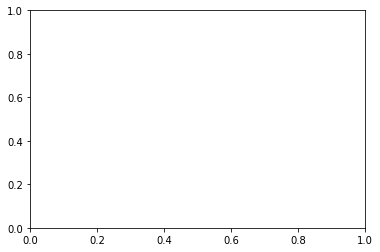

In [17]:
ax = sns.kdeplot(data=odf, x="age",hue="sex", common_norm=False,fill=True)
ax.set_title("Distribution of age")
COLS_TO_PLOT = ["age", "limit_bal", "previous_payment_sep"]
pair_plot = sns.pairplot(odf[COLS_TO_PLOT], kind="reg",diag_kind="kde", height=4,plot_kws={"line_kws":{"color":"red"}})
pair_plot.fig.suptitle("Pairplot of selected variables")

ValueError: could not convert string to float: 'Female'

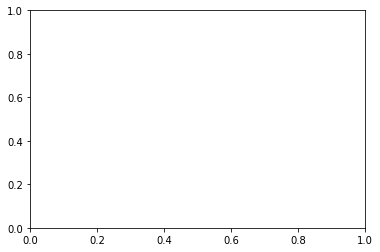

In [18]:
ax = sns.kdeplot(data=odf, x="age",hue="sex", common_norm=False,fill=True)
ax.set_title("Distribution of age")